In [1]:
import os
import sys

import matplotlib.pyplot as plt
import numpy as np
import torch

from tqdm import tqdm

sys.path.insert(0, "../")

%load_ext autoreload
%autoreload 2

/cvlabdata2/home/davydov/miniconda3/envs/hmr_ssl/lib/python3.10/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
import src

In [3]:
from src.models.hmr import get_hmr
from src.functional.hmr import hmr_inference
def get_hmr_pretrained(ckpt_path):
    ### load hmrnet
    hmrnet = get_hmr(pretrained=True)
    ckpt = torch.load(ckpt_path, map_location="cpu")
    hmrnet.load_state_dict(ckpt["hmrnet_state_dict"])
    hmrnet.eval();
    return hmrnet

In [4]:
from src.datasets.datasets_common import UNNORMALIZE
from src.functional.smpl import get_smpl_model
from src.utils.vis_utils import render_mesh_onto_image_batch
from src.utils.vis_utils import make_square_grid

In [5]:
device = "cuda:0"
smpl_model = get_smpl_model().to(device)
smpl_model_faces = torch.tensor(smpl_model.faces.astype(int).copy()).unsqueeze(0)

In [ ]:
from src.datasets.coco_eft import COCO_EFT
coco_eft_ds = COCO_EFT(is_train=False)

In [38]:
from src.datasets.threedpw import ThreeDPW
seqlen = 2
threedpw_ds_te = ThreeDPW(set="test", seqlen=seqlen, debug=True, overlap=0., output_types=['video'])
threedpw_ds_tr = ThreeDPW(set="train", seqlen=seqlen, debug=True, overlap=0., output_types=['video'])
threedpw_ds = torch.utils.data.ConcatDataset([threedpw_ds_tr, threedpw_ds_te])

3DPW Dataset overlap ratio:  0.0
Loaded 3dpw dataset from /cvlabdata2/home/davydov/videoHMR_SSL/data/3dpw/3dpw_processed/test/3dpw_test_db.pt
3dpw - number of dataset objects 17273
3DPW Dataset overlap ratio:  0.0
Loaded 3dpw dataset from /cvlabdata2/home/davydov/videoHMR_SSL/data/3dpw/3dpw_processed/train/3dpw_train_db.pt
3dpw - number of dataset objects 11321


In [41]:
from src.datasets.pennaction import PennAction
seqlen = 2
pennaction_ds = PennAction(seqlen=seqlen)

Loaded pennaction dataset from /cvlabsrc1/cvlab/dataset_PennAction/Penn_Action/../pennaction_train_scale12_db.pt
pennaction - number of dataset objects 81343


In [50]:
from src.datasets.h36m import Human36M
seqlen = 2
h36m_ds_tr = Human36M(seqlen=seqlen, set="train", debug=True, overlap=0., output_types=['video'])
h36m_ds_te = Human36M(seqlen=seqlen, set="test", debug=True, overlap=0., output_types=['video'])
h36m_ds = torch.utils.data.ConcatDataset([h36m_ds_tr, h36m_ds_te])

Human36M Dataset overlap ratio:  0.0
Loaded h36m dataset from /cvlabdata2/home/davydov/videoHMR_SSL/data/h36m/h36m_train_25fps_db.pt
h36m - number of dataset objects 146965
Human36M Dataset overlap ratio:  0.0
Loaded h36m dataset from /cvlabdata2/home/davydov/videoHMR_SSL/data/h36m/h36m_test_25fps_db.pt
h36m - number of dataset objects 54386


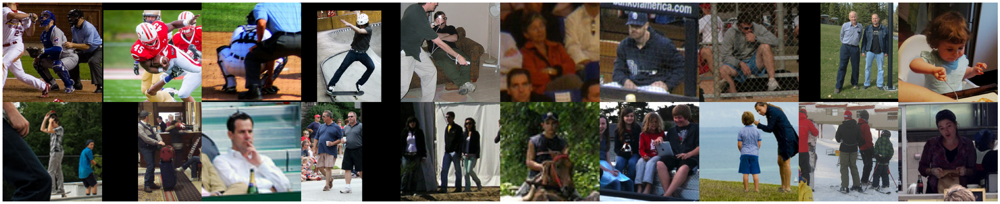

In [42]:
torch.manual_seed(0)
batch_size = 20
coco_eft_dl = torch.utils.data.DataLoader(coco_eft_ds, batch_size=batch_size, shuffle=True)
for sample in coco_eft_dl:
    img_coco = UNNORMALIZE(sample['img']).permute(0,2,3,1)
    break
img_coco = img_coco.view(2,batch_size//2,224,224,3)
img_coco = torch.cat(list(img_coco), dim=-3)
img_coco = torch.cat(list(img_coco), dim=-2)
img_coco.shape

fig, ax = plt.subplots(1,1,figsize=(10*5,2*5))
ax.imshow(img_coco)
ax.set_axis_off()

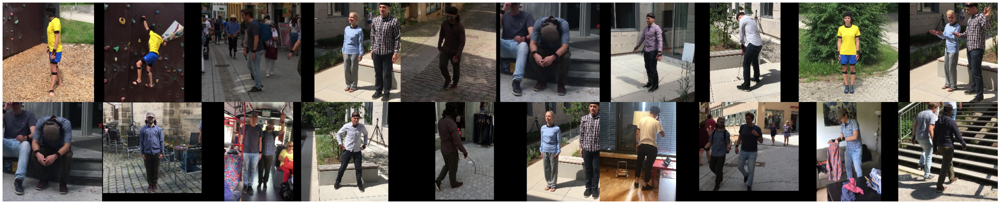

In [43]:
torch.manual_seed(1)
batch_size = 20
threedpw_dl = torch.utils.data.DataLoader(threedpw_ds, batch_size=batch_size, shuffle=True)
for sample in threedpw_dl:
    img_3dpw = UNNORMALIZE(sample['video'][:,0]).permute(0,2,3,1)
    break
img_3dpw = img_3dpw.view(2,batch_size//2,224,224,3)
img_3dpw = torch.cat(list(img_3dpw), dim=-3)
img_3dpw = torch.cat(list(img_3dpw), dim=-2)
img_3dpw.shape

fig, ax = plt.subplots(1,1,figsize=(10*5,2*5))
ax.imshow(img_3dpw)
ax.set_axis_off()

## inference on PennAction

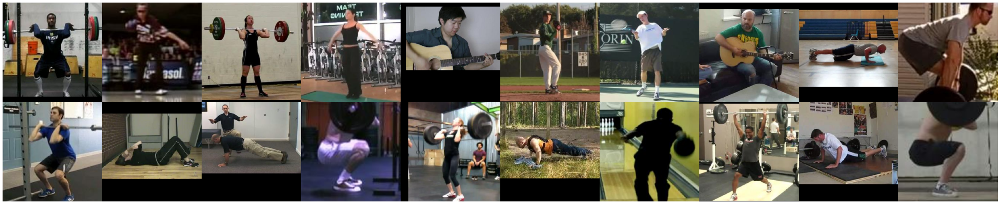

In [44]:
torch.manual_seed(1)
batch_size = 20
pennaction_dl = torch.utils.data.DataLoader(pennaction_ds, batch_size=batch_size, shuffle=True)
for sample in pennaction_dl:
    img_pa = UNNORMALIZE(sample['video'][:,0]).permute(0,2,3,1)
    break
img_pa = img_pa.view(2,batch_size//2,224,224,3)
img_pa = torch.cat(list(img_pa), dim=-3)
img_pa = torch.cat(list(img_pa), dim=-2)
img_pa.shape

fig, ax = plt.subplots(1,1,figsize=(10*5,2*5))
ax.imshow(img_pa)
ax.set_axis_off()

## inference on H36M

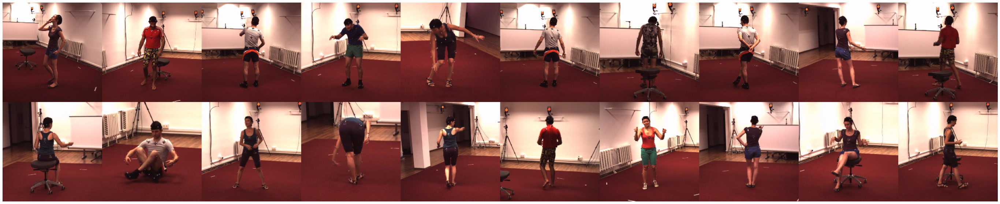

In [51]:
torch.manual_seed(1)
batch_size = 20
h36m_dl = torch.utils.data.DataLoader(h36m_ds, batch_size=batch_size, shuffle=True)
for sample in h36m_dl:
    img_h36m = UNNORMALIZE(sample['video'][:,0]).permute(0,2,3,1)
    break
img_h36m = img_h36m.view(2,batch_size//2,224,224,3)
img_h36m = torch.cat(list(img_h36m), dim=-3)
img_h36m = torch.cat(list(img_h36m), dim=-2)
img_h36m.shape

fig, ax = plt.subplots(1,1,figsize=(10*5,2*5))
ax.imshow(img_h36m)
ax.set_axis_off()

In [52]:
img_h36m.shape

torch.Size([448, 2240, 3])

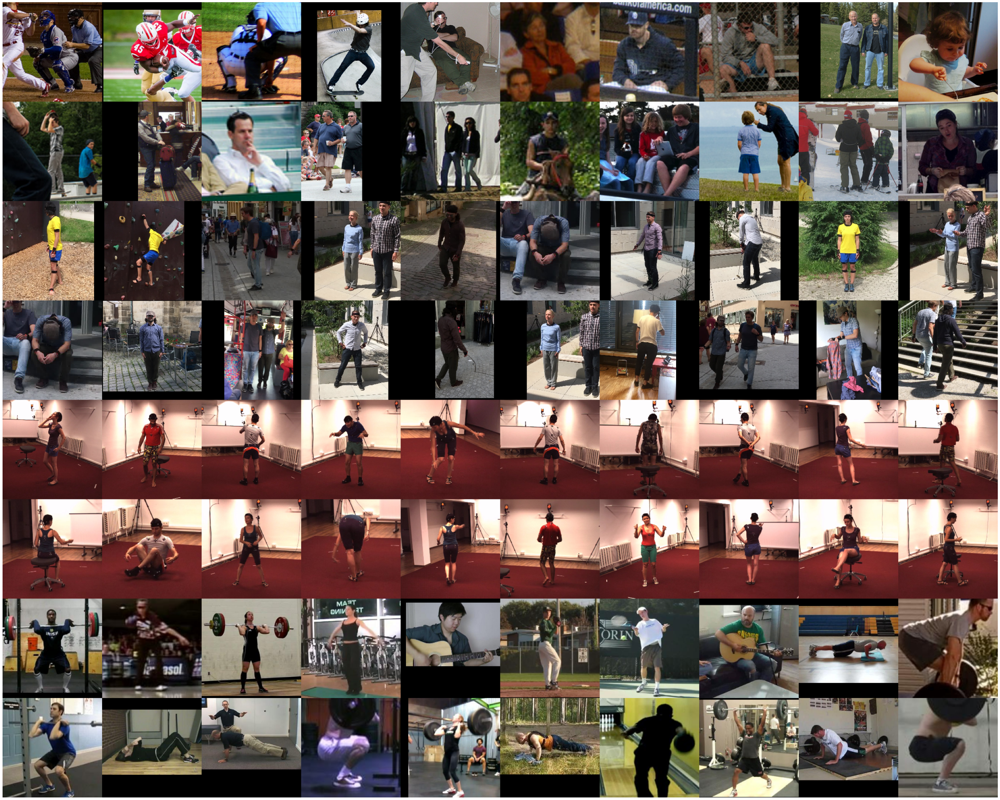

In [55]:
final = torch.cat((img_coco, img_3dpw, img_h36m, img_pa), dim=0)
fig, ax = plt.subplots(1,1,figsize=(10*5,4*2*5))
ax.imshow(final)
ax.set_axis_off()

fig.savefig(f"./../paper_sub/datasets.pdf", format="pdf", bbox_inches="tight")

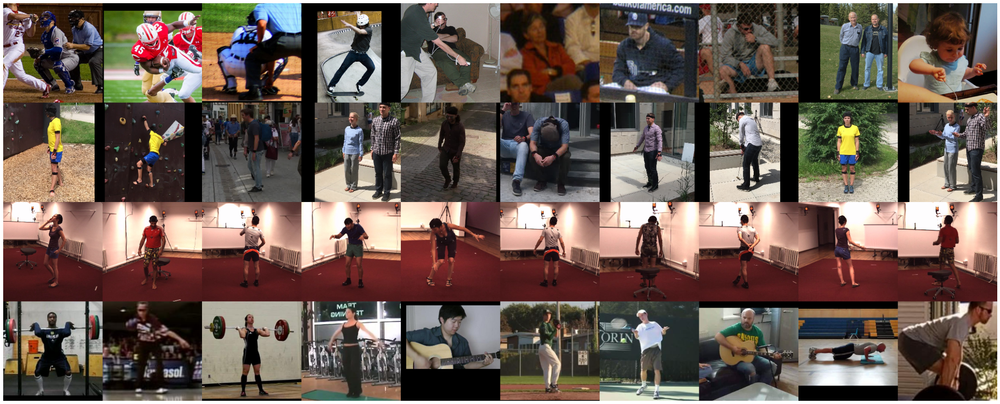

In [57]:
# smaller version

final = torch.cat((img_coco[:224], img_3dpw[:224], img_h36m[:224], img_pa[:224]), dim=0)
fig, ax = plt.subplots(1,1,figsize=(10*4,4*4))
ax.imshow(final)
ax.set_axis_off()

fig.savefig(f"./../paper_sub/datasets_half.pdf", format="pdf", bbox_inches="tight")